<a href="https://colab.research.google.com/github/yns030506/Colab_nlp-study/blob/main/LSA_nlp_03.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<군집 분석>

- 군집 분석 : 데이터의 특성에 따라 유사한 것끼리 묶음.
- 유사성을 기반으로 군집 분류, 군집에 따라 유형별 특징 분석
- 텍스트에 대한 군집 분석에서는 묶인 텍스트-유사, 다른군집-최대한 유사하지 않게 분류.

<텍스트 유사도>

- Jaccard Similarity : 두 텍스트 문서 간 공통 용어 수, 해당 텍스트에 존재하는 총 고유 용어 수의 비율 사용
- cosine Similarity : 벡터 표현 사이의 각도에 대한 코사인 값을 사용. BoW와 TF-IDF 행렬은 텍스트에 대한 벡터 표현으로 활용 가능

In [1]:
import nltk
nltk.download('punkt')
nltk.download('wordnet')

from nltk import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


In [2]:
def jaccard_similarity(d1, d2):  #문서 2개
  lemmatizer = WordNetLemmatizer()

  words1 = [lemmatizer.lemmatize(word.lower()) for word in word_tokenize(d1)]
  words2 = [lemmatizer.lemmatize(word.lower()) for word in word_tokenize(d2)]


  inter =len( set(words1).intersection(set(words2)))
  union = len(set(words1).union(set(words2)))

  return inter/union

In [4]:
d1 = "Think like a man of action and act like man of thought."
d2 = "Try not to become a man of success but rather try to become a man of value."
d3 = "Give me liberty, of give me death."

print(jaccard_similarity(d1, d2))
print(jaccard_similarity(d2, d3))
print(jaccard_similarity(d1, d3))

0.2222222222222222
0.11764705882352941
0.13333333333333333


In [22]:
tiv = TfidfVectorizer()
corpus = [d1, d2, d3]

tfidf = tiv.fit_transform(corpus).toarray()

print(cosine_similarity(tfidf[0].reshape(1, -1), tfidf[1].reshape(1, -1))) #reshape에 -1을 넣으면 numpy가 알아서 배열의 요소 수를 계산해서 넣음.
print(cosine_similarity(tfidf[0].reshape(1, -1), tfidf[2].reshape(1, -1)))
print(cosine_similarity(tfidf[1].reshape(1, -1), tfidf[2].reshape(1, -1)))

[[0.22861951]]
[[0.06083323]]
[[0.04765587]]


<한국어 형태소 분석기 설치>

In [23]:
!pip install konlpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.4/19.4 MB 46.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 488.6/488.6 kB 28.1 MB/s eta 0:00:00


In [24]:
!sudo apt-get install curl git

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
curl is already the newest version (7.81.0-1ubuntu1.18).
git is already the newest version (1:2.34.1-1ubuntu1.11).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


In [28]:
!pip install mecab-python3
#얘가 install돼야 아래 코드가 실행되나봄

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 581.7/581.7 kB 6.4 MB/s eta 0:00:00


In [29]:
!bash <(curl -s https://raw.githubusercontent.com/konlpy/konlpy/master/scripts/mecab.sh)

Install mecab-ko
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 1381k  100 1381k    0     0  1104k      0  0:00:01  0:00:01 --:--:-- 5156k
mecab-0.996-ko-0.9.2/
mecab-0.996-ko-0.9.2/example/
mecab-0.996-ko-0.9.2/example/example.cpp
mecab-0.996-ko-0.9.2/example/example_lattice.cpp
mecab-0.996-ko-0.9.2/example/example_lattice.c
mecab-0.996-ko-0.9.2/example/example.c
mecab-0.996-ko-0.9.2/example/thread_test.cpp
mecab-0.996-ko-0.9.2/mecab-config.in
mecab-0.996-ko-0.9.2/man/
mecab-0.996-ko-0.9.2/man/Makefile.am
mecab-0.996-ko-0.9.2/man/mecab.1
mecab-0.996-ko-0.9.2/man/Makefile.in
mecab-0.996-ko-0.9.2/mecab.iss.in
mecab-0.996-ko-0.9.2/config.guess
mecab-0.996-ko-0.9.2/README
mecab-0.996-ko-0.9.2/COPYING
mecab-0.996-ko-0.9.2/CHANGES.md
mecab-0.996-ko-0.9.2/README.md
mecab-0.996-ko-0.9.2/INSTALL
mecab-0

<데이터 전처리>

In [37]:
import urllib.request

raw = urllib.request.urlopen('https://raw.githubusercontent.com/e9t/nsmc/master/ratings.txt').readlines()
print(raw[:5])

[b'id\tdocument\tlabel\n', b'8112052\t\xec\x96\xb4\xeb\xa6\xb4\xeb\x95\x8c\xeb\xb3\xb4\xea\xb3\xa0 \xec\xa7\x80\xea\xb8\x88\xeb\x8b\xa4\xec\x8b\x9c\xeb\xb4\x90\xeb\x8f\x84 \xec\x9e\xac\xeb\xb0\x8c\xec\x96\xb4\xec\x9a\x94\xe3\x85\x8b\xe3\x85\x8b\t1\n', b'8132799\t\xeb\x94\x94\xec\x9e\x90\xec\x9d\xb8\xec\x9d\x84 \xeb\xb0\xb0\xec\x9a\xb0\xeb\x8a\x94 \xed\x95\x99\xec\x83\x9d\xec\x9c\xbc\xeb\xa1\x9c, \xec\x99\xb8\xea\xb5\xad\xeb\x94\x94\xec\x9e\x90\xec\x9d\xb4\xeb\x84\x88\xec\x99\x80 \xea\xb7\xb8\xeb\x93\xa4\xec\x9d\xb4 \xec\x9d\xbc\xea\xb5\xb0 \xec\xa0\x84\xed\x86\xb5\xec\x9d\x84 \xed\x86\xb5\xed\x95\xb4 \xeb\xb0\x9c\xec\xa0\x84\xed\x95\xb4\xea\xb0\x80\xeb\x8a\x94 \xeb\xac\xb8\xed\x99\x94\xec\x82\xb0\xec\x97\x85\xec\x9d\xb4 \xeb\xb6\x80\xeb\x9f\xac\xec\x9b\xa0\xeb\x8a\x94\xeb\x8d\xb0. \xec\x82\xac\xec\x8b\xa4 \xec\x9a\xb0\xeb\xa6\xac\xeb\x82\x98\xeb\x9d\xbc\xec\x97\x90\xec\x84\x9c\xeb\x8f\x84 \xea\xb7\xb8 \xec\x96\xb4\xeb\xa0\xa4\xec\x9a\xb4\xec\x8b\x9c\xec\xa0\x88\xec\x97\x90 \xeb\x81\x9d

In [38]:
raw = [x.decode() for x in raw[1:]]

reviews = []
for i in raw:
  reviews.append(i.split('\t')[1])

print(reviews[:5])

['어릴때보고 지금다시봐도 재밌어요ㅋㅋ', '디자인을 배우는 학생으로, 외국디자이너와 그들이 일군 전통을 통해 발전해가는 문화산업이 부러웠는데. 사실 우리나라에서도 그 어려운시절에 끝까지 열정을 지킨 노라노 같은 전통이있어 저와 같은 사람들이 꿈을 꾸고 이뤄나갈 수 있다는 것에 감사합니다.', '폴리스스토리 시리즈는 1부터 뉴까지 버릴께 하나도 없음.. 최고.', '와.. 연기가 진짜 개쩔구나.. 지루할거라고 생각했는데 몰입해서 봤다.. 그래 이런게 진짜 영화지', '안개 자욱한 밤하늘에 떠 있는 초승달 같은 영화.']


In [40]:
from konlpy.tag import Mecab

tagger = Mecab()
reviews = [tagger.morphs(x) for x in reviews]

print(reviews)

[['어릴', '때', '보', '고', '지금', '다시', '봐도', '재밌', '어요', 'ㅋㅋ'], ['디자인', '을', '배우', '는', '학생', '으로', ',', '외국', '디자이너', '와', '그', '들', '이', '일군', '전통', '을', '통해', '발전', '해', '가', '는', '문화', '산업', '이', '부러웠', '는데', '.', '사실', '우리', '나라', '에서', '도', '그', '어려운', '시절', '에', '끝', '까지', '열정', '을', '지킨', '노라노', '같', '은', '전통', '이', '있', '어', '저', '와', '같', '은', '사람', '들', '이', '꿈', '을', '꾸', '고', '이뤄나갈', '수', '있', '다는', '것', '에', '감사', '합니다', '.'], ['폴리스', '스토리', '시리즈', '는', '1', '부터', '뉴', '까지', '버릴', '께', '하나', '도', '없', '음', '.', '.', '최고', '.'], ['와', '.', '.', '연기', '가', '진짜', '개', '쩔', '구나', '.', '.', '지루', '할거', '라고', '생각', '했', '는데', '몰입', '해서', '봤', '다', '.', '.', '그래', '이런', '게', '진짜', '영화', '지'], ['안개', '자욱', '한', '밤하늘', '에', '떠', '있', '는', '초승달', '같', '은', '영화', '.'], ['사랑', '을', '해', '본', '사람', '이', '라면', '처음', '부터', '끝', '까지', '웃', '을', '수', '있', '는', '영화'], ['완전', '감동', '입니다', '다시', '봐도', '감동'], ['개', '들', '의', '전쟁', '2', '나오', '나요', '?', '나오', '면', '1', '빠', '로', '보', '고', '싶', '음'

<Word2Vec 생성>

- word2vec은 임베딩 기법.

In [41]:
# 필요 라이브러리 추가
from gensim.models import Word2Vec
from sklearn.manifold import TSNE
from matplotlib import font_manager as fm
from matplotlib import rc

In [42]:
#gensim의 Word2Vec은 선언과 동시에 학습을 해 단어 벡터들 생성
word2vec = Word2Vec(reviews, min_count = 5)
word2vec

In [44]:
word2vec.wv.most_similar('영화')

[('드라마', 0.6532694697380066),
 ('작품', 0.6292782425880432),
 ('수작', 0.5994676947593689),
 ('애니메이션', 0.5874998569488525),
 ('애니', 0.5693016052246094),
 ('스릴러', 0.5579688549041748),
 ('다큐', 0.549875020980835),
 ('만화', 0.5279366970062256),
 ('독립영화', 0.5247536301612854),
 ('졸작', 0.5172803401947021)]

In [45]:
#t-sne를 이용한 단어 벡터 시각화
tsne = TSNE(n_components = 2)
tsne

TSNE()

In [57]:
import numpy as np
vocab = word2vec.wv.key_to_index
vocab

def similarity(vocab):
  a = []
  for k in vocab:
    sim = word2vec.wv[k]
    a.append(sim)
  return np.array(a)

similarity = similarity(vocab)
similarity


array([[ 0.13652794,  0.46903488,  0.2507846 , ..., -0.270043  ,
        -0.83670884,  0.74139065],
       [-0.8985157 ,  1.6327688 ,  1.1575614 , ..., -0.69244874,
        -0.7581742 ,  0.7721329 ],
       [ 0.2784488 , -0.5337185 ,  1.3744441 , ..., -0.00668644,
         1.0297176 , -1.8010355 ],
       ...,
       [ 0.02612487,  0.05272329,  0.05037726, ..., -0.05635554,
        -0.0299655 , -0.01554515],
       [-0.02107196,  0.08055269,  0.03860181, ..., -0.00398879,
         0.05741414,  0.04865059],
       [ 0.00265746,  0.00848305,  0.05644037, ...,  0.01620189,
        -0.0918191 ,  0.03070086]], dtype=float32)

In [59]:
import pandas as pd

transform_similarity = tsne.fit_transform(similarity)
df = pd.DataFrame(transform_similarity, index = vocab, columns = ['x', 'y'])
df[0:10]

,x,y
.,17.306568,-53.690845
이,37.392376,-33.472038
는,30.590540,-44.426956
영화,59.576870,15.406172
다,7.851743,50.932724
고,10.092821,50.170605
하,34.238258,-24.446463
도,26.628815,-54.523830
의,35.293793,-21.513964
가,22.791729,53.646530


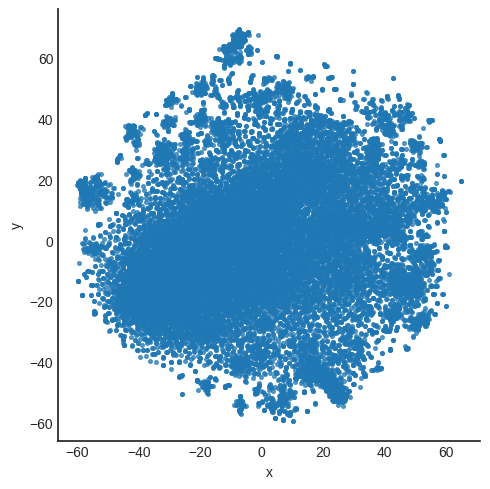

In [74]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use('seaborn-v0_8-white')
sns.lmplot(x = 'x',y =  'y', data=df, fit_reg=False, scatter_kws={'alpha':0.7,'s':7})
# plt.figure(figsize=(8, 6))
plt.show()

# 뭔가 잘못된거같음 내꺼. ..

<Scikit-learn, Scipy를 이용한 계층적 군집화>

- 계층적 군집화 : 개별 개체들을 유사한 개체나 그룹으로 통합해 군집화를 수행하는 알고리즘
- 비계층적 군집화와는 달리 군집 수를 지정하지 않아도 군집화를 할 수 있는 장점
- 계층적 군집화는 모든 개체간 거리나 유사도가 미리 계산되어 있어야만 하며, 계산복잡도도 비계층적 군집화보다 큼.

<Scikit-learn>

- 비계층적 군집화의 일종인 agglomerativeClustering(병합 군집) 사용.
- 병합 군집 : 각 개체를 클러스터로 간주, 종료 조건을 만족할 때까지 가장 비슷한 두 클러스터들을 합치며 진행.
- 종료 조건
  1. ward : 모든 클러스터 내의 분산을 가장 적게 증가시키는 두 클러스터를 합침(default)
  2. average - 평균 거리가 가장 짧은 두 클러스터를 합침.
  3. complete - 클러스터간 최대 거리가 가장 짧은 두 클러스터를 합침

In [75]:
#ward

from sklearn.cluster import AgglomerativeClustering

ward = AgglomerativeClustering(n_clusters = 6, linkage = 'ward')
predict = ward.fit_predict(df)
predict

array([2, 5, 2, ..., 0, 0, 4])

In [76]:
results = df
results['predict'] = predict
results[0:10]

,x,y,predict
.,17.306568,-53.690845,2
이,37.392376,-33.472038,5
는,30.590540,-44.426956,2
영화,59.576870,15.406172,1
다,7.851743,50.932724,3
고,10.092821,50.170605,3
하,34.238258,-24.446463,5
도,26.628815,-54.523830,2
의,35.293793,-21.513964,5
가,22.791729,53.646530,1


<function matplotlib.pyplot.show(close=None, block=None)>

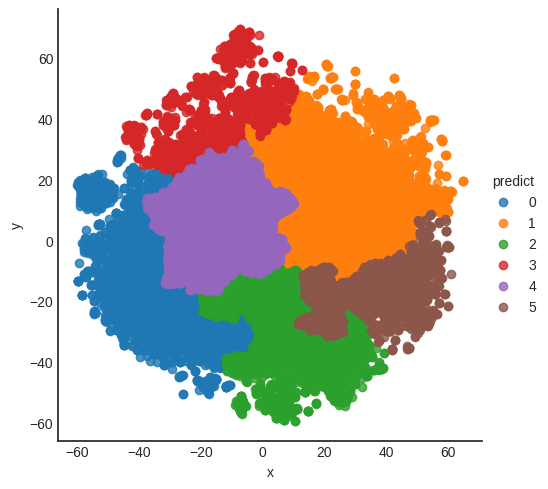

In [78]:
sns.lmplot(x='x', y='y', data=results, fit_reg=False, hue="predict")
plt.show

In [79]:
# average

avg = AgglomerativeClustering(n_clusters = 6, linkage='average')
predict = avg.fit_predict(df)
predict

array([3, 1, 3, ..., 5, 5, 2])

In [80]:
results = df
results['predict'] = predict
results[0:10]

,x,y,predict
.,17.306568,-53.690845,3
이,37.392376,-33.472038,1
는,30.590540,-44.426956,3
영화,59.576870,15.406172,1
다,7.851743,50.932724,0
고,10.092821,50.170605,0
하,34.238258,-24.446463,1
도,26.628815,-54.523830,3
의,35.293793,-21.513964,1
가,22.791729,53.646530,0


<function matplotlib.pyplot.show(close=None, block=None)>

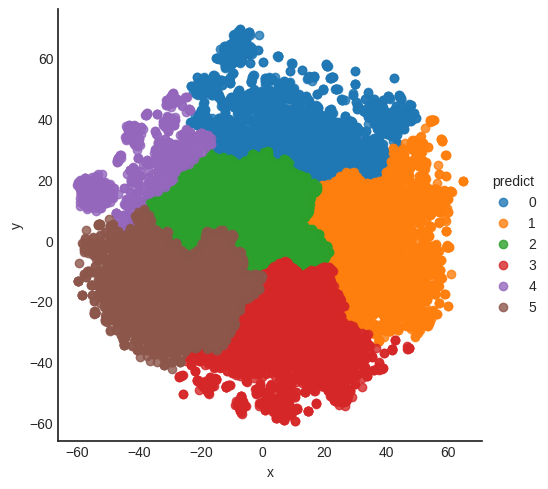

In [81]:
sns.lmplot(x='x', y='y', data=results, fit_reg=False, hue="predict")
plt.show

In [82]:
# complete

compl = AgglomerativeClustering(n_clusters = 6, linkage='complete')
predict = compl.fit_predict(df)
predict

array([4, 4, 4, ..., 2, 2, 0])

In [83]:
results = df
results['predict'] = predict
results[0:10]

,x,y,predict
.,17.306568,-53.690845,4
이,37.392376,-33.472038,4
는,30.590540,-44.426956,4
영화,59.576870,15.406172,1
다,7.851743,50.932724,0
고,10.092821,50.170605,0
하,34.238258,-24.446463,3
도,26.628815,-54.523830,4
의,35.293793,-21.513964,3
가,22.791729,53.646530,1


<function matplotlib.pyplot.show(close=None, block=None)>

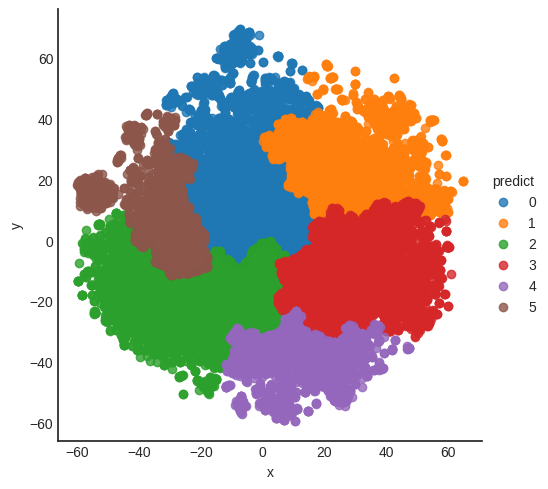

In [84]:
sns.lmplot(x='x', y='y', data=results, fit_reg=False, hue="predict")
plt.show

<Scipy>

- scipy를 이용한 거리 사용과 word2vec 사용을 비교
- pdist -> 각 단어 간 유클리디안 거리 계산

In [87]:
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram

distmatrix = pdist(df, metric='euclidean')
row_dist = pd.DataFrame(squareform(distmatrix))
row_dist

,0,1,2,3,4,5,6,7,8,9,...,18961,18962,18963,18964,18965,18966,18967,18968,18969,18970
0,0.000000,28.499822,16.195171,81.056624,105.126043,104.188478,33.807042,9.359388,36.876713,107.519297,...,61.387514,37.884191,69.436119,84.926984,60.316192,74.550488,47.180863,49.592263,60.754564,68.822815
1,28.499822,0.000000,12.894774,53.760870,89.514317,88.075862,9.612985,23.643862,12.181937,88.384523,...,75.730424,54.229214,84.693116,89.583914,71.243863,57.872010,38.014758,60.876080,75.865742,62.733677
2,16.195171,12.894774,0.000000,66.552314,98.114838,96.875461,20.335338,10.846296,23.412087,98.428808,...,70.792031,47.880885,79.463938,89.257247,67.773346,66.589816,42.633413,56.991139,70.578483,66.778573
3,81.056624,53.760870,66.552314,0.000000,62.758463,60.483360,47.268147,77.361357,44.235328,53.061018,...,106.544928,92.575913,115.081407,103.016289,98.527239,42.399176,54.431896,91.576846,107.675250,66.924148
4,105.126043,89.514317,98.114838,62.758463,0.000000,2.367120,79.920398,107.189847,77.527986,15.217356,...,90.679142,91.383824,96.016263,67.900659,81.359543,31.663219,58.134126,81.528512,92.669832,43.118966
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18966,74.550488,57.872010,66.589816,42.399176,31.663219,30.313163,48.276066,75.930584,45.937100,33.267603,...,73.469221,67.231469,80.844957,62.343887,64.351848,0.000000,28.934890,60.718888,75.094874,26.759344
18967,47.180863,38.014758,42.633413,54.431896,58.134126,57.331549,29.777067,50.265397,29.079445,62.083816,...,52.166156,40.185799,60.778656,54.657685,44.370244,28.934890,0.000000,37.234153,53.285277,24.792802
18968,49.592263,60.876080,56.991139,91.576846,81.528512,81.699265,57.046006,57.820574,58.182490,90.554973,...,15.485109,13.904299,24.497162,36.877244,10.844860,60.718888,37.234153,0.000000,16.260200,38.478021
18969,60.754564,75.865742,70.578483,107.675250,92.669832,93.155283,72.749301,69.689689,74.056246,103.108123,...,2.157705,22.982218,8.893405,35.957630,11.316459,75.094874,53.285277,16.260200,0.000000,50.669287


In [88]:
row_clusters = linkage(distmatrix, method='complete')

plt.figure(figsize=(20,10))
dendrogram(row_clusters, # 토너먼트 표같이 생긴 그림 나옴
           leaf_rotation=50,
           leaf_font_size=7)
plt.show()

KeyboardInterrupt: 

In [89]:
mergins = linkage(df, method = 'complete')

plt.figure(figsize=(20,10))
dendrogram(mergins, # 토너먼트 표같이 생긴 그림 나옴
           leaf_rotation=50,
           leaf_font_size=7)
plt.show()

KeyboardInterrupt: 

<scikit-learn을 이용한 비계층적 군집화>

- 나눌 클러스터를 지정해 각 개체가 어느 클러스터에 속하는지를 결정
- 계층적 군집화에 비해 계산복잡도 작음->대량의 데이터에 유리. 그런데 클러스터 개수에 따라 군집화 성능이 크게 좌우되기 때문에 조정이 필요.

- 대표 : kmeans

In [90]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters = 3)
predict = kmeans.fit_predict(df)
predict

array([0, 1, 1, ..., 0, 0, 2], dtype=int32)

In [95]:
results = df
results['predict'] = predict
results[0:10]

,x,y,predict
.,17.306568,-53.690845,0
이,37.392376,-33.472038,0
는,30.590540,-44.426956,0
영화,59.576870,15.406172,3
다,7.851743,50.932724,4
고,10.092821,50.170605,4
하,34.238258,-24.446463,3
도,26.628815,-54.523830,0
의,35.293793,-21.513964,3
가,22.791729,53.646530,4


<function matplotlib.pyplot.show(close=None, block=None)>

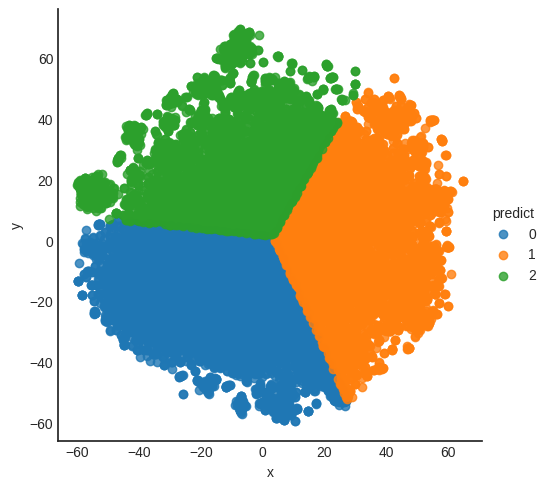

In [93]:
sns.lmplot(x='x', y='y', data=results, fit_reg=False, hue="predict")
plt.show

In [94]:
kmeans = KMeans(n_clusters = 6)
predict = kmeans.fit_predict(df)
predict

array([0, 0, 0, ..., 2, 2, 1], dtype=int32)

In [96]:
results = df
results['predict'] = predict
results[0:10]

,x,y,predict
.,17.306568,-53.690845,0
이,37.392376,-33.472038,0
는,30.590540,-44.426956,0
영화,59.576870,15.406172,3
다,7.851743,50.932724,4
고,10.092821,50.170605,4
하,34.238258,-24.446463,3
도,26.628815,-54.523830,0
의,35.293793,-21.513964,3
가,22.791729,53.646530,4


<function matplotlib.pyplot.show(close=None, block=None)>

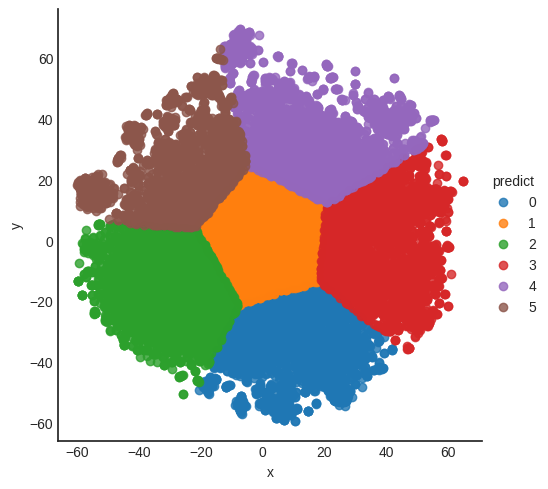

In [98]:
sns.lmplot(x='x', y='y', data=results, fit_reg=False, hue="predict")
plt.show